# **Style Transfer of Images and Videos**

## **Section 1: Configuration**

In [ ]:
#------------------General Configs---------------------------------------------#
# Mode (IMPORTANT: Make sure you are on the correct mode!)
# 3 modes: 'TRAIN', 'IMAGE', 'VIDEO'
# >>> 1. use 'TRAIN' to learn weights of a particular style
# >>> 2. use 'IMAGE' to transfrom a image using existing transformation weights
# >>> 3. use 'VIDEO' to transfrom a video using existing transformation weights
# >>> 4. use 'VALIDATION' to test on multipule images
MODE = 'VALIDATION'

# Paths
ROOT = '/content/drive/MyDrive/style_transfer' # Project root path in Google Drive
CONTENT_IMAGE_DIR = 'images/content_images' # Directory of content images in Google Drive
STYLE_IMAGE_DIR = 'images/style_images' # Directory of style images in Google Drive
RESULT_IMAGE_DIR = 'images/result_images' # Directory of result images in Google Drive
TRANSFORMATIONS_DIR = 'trained_transformations' # Directory of saved transformation weights in Google Drive
CONTENT_VIDEO_DIR = 'videos/content_videos/car_shanghai' # Directory of content videos in Google Drive
RESULT_VIDEO_DIR = 'videos/result_videos/car_shanghai' # Directory of result videos in Google Drive

# Random seed
SEED = 0
#------------------------------------------------------------------------------#

#------------------Training Configs--------------------------------------------#
CONTINUE_FROM_PREVIOUS_WEIGHTS = False # If False, train a fresh model
PREVIOUS_WEIGHTS_PATH = '/content/drive/MyDrive/style_transfer/training_checkpoints/workshop_20221125_1669397153/model_checkpoints/workshop_checkpoint_6000.pth'
STYLE_IMAGE_NAME = 'tower.jpg' # Filename of style image
CONTENT_WEIGHT = 7
STYLE_WEIGHT = 68
TRAIN_IMAGE_SIZE = 256
NUM_EPOCHS = 1
TRAIN_BATCH_SIZE = 4 
ADAM_LR = 0.001
SAVE_MODEL_EVERY = 500
CHECKPOINT_DIR = "training_checkpoints" # Directory in Google Drive where checkpoints are saved
DATASET_PATH = '/content/train_data' # Path where training data is stored (DO NOT CHANGE)
LOSS_NETWORK_PATH = '/content/pretrained_loss_network' # Path of pretrained loss network weights (DO NOT CHANGE)
#------------------------------------------------------------------------------#

#------------------Image Style Transfer Configs--------------------------------#
CONTENT_IMAGE_NAME = 'mountain_min.jpeg' # Filename of input content image
RESULT_IMAGE_NAME = 'mountain_min_transformed' # The output image's filename is generated according to this
TRANSFORMATION_IMAGE_WEIGHTS = 'wave_weights.pth' # Filename of pretrained transformation (style) weights
#------------------------------------------------------------------------------#

#------------------Video Style Transfer Configs--------------------------------#
CONTENT_VIDEO_NAME = "walkway.mp4" # Filename of input content video
RESULT_VIDEO_NAME = "walkway_mosaic_transformed" # The output video's filename is generated according to this
TRANSFORMATION_VIDEO_WEIGHTS = "mosaic_weights.pth" # Filename of pretrained transformation (style) weights
BATCH_SIZE = 2 # Increase if you have larger GPU RAM
CONTENT_FRAMES_DATASET_DIR = "/content/video_processing/extracted_frames" # (DO NOT CHANGE)
CONTENT_FRAMES_DIR = "/content/video_processing/extracted_frames/content_frames" # (DO NOT CHANGE)
STYLE_FRAMES_SAVING_PATH = "/content/video_processing/style_frames" # (DO NOT CHANGE)
#------------------------------------------------------------------------------#

## **Section 2: Setup**


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Create directories**

In [ ]:
%cd /content
# Video style transfer directories
!mkdir -p video_processing/extracted_frames/content_frames
!mkdir -p video_processing/style_frames

/content


**Download dataset and VGG16 pretrained weights**

The downloads are only required for the training part. Style tranfer using existing pretrained weights does not need the downloaded contents.

In [ ]:
if MODE == 'TRAIN' or MODE == 'VALIDATION':
    sh = """
    echo 'Downloading training dataset...'
    cd /content
    wget -nc http://images.cocodataset.org/zips/train2017.zip
    mkdir -p train_data
    unzip -n -qq train2017.zip -d train_data
    rm train2017.zip
    echo 'Downloading VGG16 pretrained weights...'
    cd /content
    mkdir -p pretrained_loss_network
    cd pretrained_loss_network
    wget -nc https://web.eecs.umich.edu/~justincj/models/vgg16-00b39a1b.pth
    """
else: 
    sh = """
    echo 'Download skipped'
    """

with open('download_script.sh', 'w') as file:
    file.write(sh)

!bash download_script.sh

--2022-12-18 19:52:44--  http://images.cocodataset.org/zips/train2017.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 52.217.79.100, 52.216.107.204, 54.231.228.217, ...
Connecting to images.cocodataset.org (images.cocodataset.org)|52.217.79.100|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 19336861798 (18G) [application/zip]
Saving to: ‘train2017.zip’

train2017.zip       100%[===================>]  18.01G  13.3MB/s    in 24m 21s 

2022-12-18 20:17:06 (12.6 MB/s) - ‘train2017.zip’ saved [19336861798/19336861798]

--2022-12-18 20:19:34--  https://web.eecs.umich.edu/~justincj/models/vgg16-00b39a1b.pth
Resolving web.eecs.umich.edu (web.eecs.umich.edu)... 141.212.113.214
Connecting to web.eecs.umich.edu (web.eecs.umich.edu)|141.212.113.214|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 553451520 (528M) [application/x-tar]
Saving to: ‘vgg16-00b39a1b.pth’

vgg16-00b39a1b.pth  100%[===================>] 527.81M  14.2MB/s  

**Import libraries**

In [ ]:
import os
import time
from datetime import datetime
import gc
import natsort

# Files
from google.colab import files

import numpy as np
import pandas as pd

# Plot
import matplotlib.pyplot as plt
import seaborn as sns

# Image
from PIL import Image

import cv2

# PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.cuda as cuda
import torch.optim as optim

from torchvision import transforms, datasets
import torchvision.models as models

from torchsummary import summary

**Set seed for random operations**

In [ ]:
np.random.seed(SEED)
torch.manual_seed(SEED)

**Set GPU**

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Sun Dec 18 20:20:20 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   46C    P0    26W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Running on:", device)

Running on: cuda


In [ ]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 13.6 gigabytes of available RAM

Not using a high-RAM runtime


## **Section 3: Helper Functions**

### **Loading, saving, and showing images**

In [ ]:
# Load image file
def load_image(path):
    # Images loaded as BGR
    image = cv2.imread(path)
    return image

# Preprocess image for showing
def preprocess_image_show(image):
    # Convert from BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # imshow() only accepts float [0,1] or int [0,255]
    image = np.array(image/255).clip(0,1)
    return image

# Show image
def show_image(image):
    image = preprocess_image_show(image)
    plt.figure(dpi=160)
    plt.axis('off')
    plt.grid(b=None)
    plt.imshow(image)
    plt.show()

# Show 2 images side by side
def show_images_side_by_side(image1, image2, title1, title2):
    image1 = preprocess_image_show(image1)
    image2 = preprocess_image_show(image2)
    f, axarr = plt.subplots(1, 2, dpi=130)
    axarr[0].imshow(image1)
    axarr[0].axis('off')
    axarr[0].set_title(title1)
    axarr[1].imshow(image2)
    axarr[1].axis('off')
    axarr[1].set_title(title2)
    plt.show()

# Save image
def save_image(image, path_to_save):
    image = image.clip(0, 255)
    cv2.imwrite(path_to_save, image)

### **Gram matrix**

In [ ]:
def gram_matrix(tensor):
    B, C, H, W = tensor.shape
    x = tensor.view(B, C, H*W)
    x_t = x.transpose(1, 2)
    return  torch.bmm(x, x_t) / (C*H*W)

### **Image/tensor conversions**

In [ ]:
# Image to Tensor
def itot(img, max_size=None):
    # Rescale the image
    if (max_size==None):
        itot_t = transforms.Compose([
            #transforms.ToPILImage(),
            transforms.ToTensor(),
            transforms.Lambda(lambda x: x.mul(255))
        ])    
    else:
        H, W, C = img.shape
        image_size = tuple([int((float(max_size) / max([H,W]))*x) for x in [H, W]])
        itot_t = transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize(image_size),
            transforms.ToTensor(),
            transforms.Lambda(lambda x: x.mul(255))
        ])

    # Convert image to tensor
    tensor = itot_t(img)

    # Add the batch_size dimension
    tensor = tensor.unsqueeze(dim=0)
    return tensor

# Tensor to Image
def ttoi(tensor):
    # Remove the batch_size dimension
    tensor = tensor.squeeze()
    #img = ttoi_t(tensor)
    img = tensor.cpu().numpy()
    
    # Transpose from [C, H, W] -> [H, W, C]
    img = img.transpose(1, 2, 0)
    return img

### **Loss history plot**

In [ ]:
def plot_loss_hist(style_loss_history, content_loss_history, loss_history):
    loss_df = pd.DataFrame({'Style Loss': style_loss_history,
                            'Content Loss': content_loss_history,
                            'Total Loss': loss_history})

    sns.set_theme()
    g = sns.lineplot(data=loss_df)
    # g.set_xticks(range(len(loss_df)))
    # g.set_xlim(50,)
    g.set_ylim(0, 0.2 * 1e8)
    plt.xlabel('Batches')
    plt.ylabel('Loss')
    plt.title('Loss History')
    plt.show()

### **Video**

In [ ]:
def extract_video_specs(video_path):
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened(): 
        print("ERROR: Video file did not open correctly")
        return

    width = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
    height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
    fps =  cap.get(cv2.CAP_PROP_FPS)

    cap.release()
    print(f"Video specs extracted => width: {width} height: {height} fps: {fps}")

    return height, width, fps

def extract_video_frames(video_path):
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened(): 
        print("ERROR: Video file did not open correctly")
        return

    # Extract frames
    count = 0
    ret, frame = cap.read()
    while ret:
        frame_path = os.path.join(CONTENT_FRAMES_DIR, f"frame{count}.jpg")
        cv2.imwrite(frame_path, frame)
        ret, frame = cap.read()
        count += 1

    cap.release()
    print(f"Content video frames extracted => Number of frames: {count}")

def create_video(frames_path, result_saving_path, fps, height, width):    
    # Sort frame filenames based on the natural ordering 
    frames = natsort.natsorted(os.listdir(frames_path))
    
    fourcc = cv2.VideoWriter_fourcc(*'MP4V')
    out = cv2.VideoWriter(result_saving_path, fourcc, fps, (width, height))

    for frame_name in frames:
        frame_path = os.path.join(frames_path, frame_name)
        frame = cv2.imread(frame_path)
        out.write(frame)
        
    print(f"Video saved at {result_saving_path}")

### **Some other functions**

In [ ]:
def garbage_collect():
    torch.cuda.empty_cache()
    gc.collect()

def get_style_name(style_image_name):
    return style_image_name.split('.')[0]

class ImageFolderWithPaths(datasets.ImageFolder):
    # override the __getitem__ method. this is the method dataloader calls
    def __getitem__(self, index):
        # this is what ImageFolder normally returns 
        original_tuple = super(ImageFolderWithPaths, self).__getitem__(index)

        # the image file path
        path = self.imgs[index][0]

        # make a new tuple that includes original and the path
        tuple_with_path = (*original_tuple, path)
        return tuple_with_path

## **Section 4: Transformer Network**

In [ ]:
class TransformerNet(nn.Module):
    def __init__(self):
        super(TransformerNet, self).__init__()
        self.f = nn.Sequential(
            # Initial convolution layers
            ConvLayer(3, 32, kernel_size=9, stride=1),
            nn.ReLU(),
            ConvLayer(32, 64, kernel_size=3, stride=2),
            nn.ReLU(),
            ConvLayer(64, 128, kernel_size=3, stride=2),
            nn.ReLU(),
            # Residual layers
            ResidualLayer(128, kernel_size=3), 
            ResidualLayer(128, kernel_size=3), 
            ResidualLayer(128, kernel_size=3), 
            ResidualLayer(128, kernel_size=3), 
            ResidualLayer(128, kernel_size=3),
            # Upsampling layers
            DeconvLayer(128, 64, kernel_size=3, stride=2, output_padding=1),
            nn.ReLU(),
            DeconvLayer(64, 32, kernel_size=3, stride=2, output_padding=1),
            nn.ReLU(),
            ConvLayer(32, 3, kernel_size=9, stride=1, norm="None")
        )

    def forward(self, x):
        y = self.f(x)
        return y

class ConvLayer(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, norm="instance"):
        super(ConvLayer, self).__init__()
        padding_size = kernel_size // 2
        self.reflection_pad = nn.ReflectionPad2d(padding_size)
        self.conv2d = nn.Conv2d(in_channels, out_channels, kernel_size, stride)

        # Normalization
        self.norm_type = norm
        if (norm=='instance'):
            self.norm2d = nn.InstanceNorm2d(out_channels, affine=True)
        elif (norm=='batch'):
            self.norm2d = nn.BatchNorm2d(out_channels, affine=True)

    def forward(self, x):
        x = self.reflection_pad(x)
        x = self.conv2d(x)
        if (self.norm_type=='None'):
            out = x
        else:
            out = self.norm2d(x)
        return out

class ResidualLayer(nn.Module):
    def __init__(self, channels=128, kernel_size=3):
        super(ResidualLayer, self).__init__()
        self.conv1 = ConvLayer(channels, channels, kernel_size, stride=1)
        self.relu = nn.ReLU()
        self.conv2 = ConvLayer(channels, channels, kernel_size, stride=1)

    def forward(self, x):
        residual = x                     
        out = self.relu(self.conv1(x))   
        out = self.conv2(out)            
        out = out + residual
        return out

class DeconvLayer(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, output_padding, norm="instance"):
        super(DeconvLayer, self).__init__()

        # Transposed Convolution 
        padding_size = kernel_size // 2
        self.conv_transpose = nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding_size, output_padding)

        # Normalization
        self.norm_type = norm
        if (norm=='instance'):
            self.norm_layer = nn.InstanceNorm2d(out_channels, affine=True)
        elif (norm=='batch'):
            self.norm_layer = nn.BatchNorm2d(out_channels, affine=True)

    def forward(self, x):
        x = self.conv_transpose(x)
        if (self.norm_type=='None'):
            out = x
        else:
            out = self.norm_layer(x)
        return out

## **Section 5: VGG Network**

In [ ]:
vgg16_path = os.path.join(LOSS_NETWORK_PATH, 'vgg16-00b39a1b.pth')
class VGG16(nn.Module):
    def __init__(self, vgg_path=vgg16_path):
        super(VGG16, self).__init__()
        # Load weights into VGG
        vgg16_features = models.vgg16(weights=None)
        vgg16_features.load_state_dict(torch.load(vgg_path), strict=False)
        self.features = vgg16_features.features

        for param in self.features.parameters():
            param.requires_grad = False

    def forward(self, x):
        layers = {'3': 'relu1_2', '8': 'relu2_2', '15': 'relu3_3', '22': 'relu4_3'}
        features = {}
        for name, layer in self.features._modules.items():
            x = layer(x)
            if name in layers:
                features[layers[name]] = x
                if (name=='22'):
                    break
        return features

## **Section 6: Training**

Steps to run *training*:
1. Properly modify configs (Section 1) and run it
    - Remember to set `MODE = 'TRAIN'`
    - Note that `CONTINUE_FROM_PREVIOUS_WEIGHTS = False` trains a fresh model from scratch while `CONTINUE_FROM_PREVIOUS_WEIGHTS = True` picks up training from a previous checkpoint specified in `PREVIOUS_WEIGHTS_PATH` (which is also something you can set in configs).
2. Run everything in Section 2, 3, 4, and 5
    - Note that training requires downloading a large data set and some pretrained weights. Will need some patience here.
4. Run `train` (the cell below)

In [ ]:
garbage_collect()

In [ ]:
def train(style_image_path, style_name,
          print_loss_history=True, plot_loss_history=True):

    print(f"The style to learn: {style_name}\n")

    # Prepare directories for checkpoints
    time_id = f"{datetime.now().strftime('%Y%m%d')}_{int(time.time())}"
    checkpoint_saving_dir = os.path.join(ROOT, CHECKPOINT_DIR, f'{style_name}_{time_id}')
    os.makedirs(checkpoint_saving_dir)
    model_checkpoint_saving_dir = os.path.join(checkpoint_saving_dir, 'model_checkpoints')
    image_checkpoint_saving_dir = os.path.join(checkpoint_saving_dir, 'image_checkpoints')
    os.makedirs(model_checkpoint_saving_dir)
    os.makedirs(image_checkpoint_saving_dir)

    # Dataset and Dataloader
    transform = transforms.Compose([
        transforms.Resize(TRAIN_IMAGE_SIZE),
        transforms.CenterCrop(TRAIN_IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x.mul(255))
    ])
    train_dataset = datasets.ImageFolder(DATASET_PATH, transform=transform)
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=TRAIN_BATCH_SIZE, shuffle=True)

    # TransformerNet
    net = TransformerNet()
    if CONTINUE_FROM_PREVIOUS_WEIGHTS:
        net.load_state_dict(torch.load(PREVIOUS_WEIGHTS_PATH))
    net = net.to(device)

    optimizer = optim.Adam(net.parameters(), lr=ADAM_LR)
    mse_loss = nn.MSELoss().to(device)

    # Pretrained loss network
    loss_net = VGG16().to(device)

    # Get Style Features
    imagenet_neg_mean = torch.tensor([-103.939, -116.779, -123.68], dtype=torch.float32).reshape(1,3,1,1).to(device)
    style_image = load_image(style_image_path)
    style_tensor = itot(style_image).to(device)
    style_tensor = style_tensor.add(imagenet_neg_mean)
    B, C, H, W = style_tensor.shape
    style_features = loss_net(style_tensor.expand([TRAIN_BATCH_SIZE, C, H, W]))
    style_gram = {}
    for key, value in style_features.items():
        style_gram[key] = gram_matrix(value)

    # Loss trackers
    content_loss_history = []
    style_loss_history = []
    total_loss_history = []
    batch_content_loss_sum = 0
    batch_style_loss_sum = 0
    batch_total_loss_sum = 0

    # Optimization/Training Loop
    batch_count = 1
    start_time = time.time()
    for epoch in range(NUM_EPOCHS):
        print(f"Epoch {epoch}:")
        for content_batch, _ in train_loader:
            # Get current batch size in case of odd batch sizes
            curr_batch_size = content_batch.shape[0]

            torch.cuda.empty_cache()
            optimizer.zero_grad()

            # Generate images and get features
            content_batch = content_batch[:,[2,1,0]].to(device)
            generated_batch = net(content_batch)
            content_features = loss_net(content_batch.add(imagenet_neg_mean))
            generated_features = loss_net(generated_batch.add(imagenet_neg_mean))

            # Content loss
            content_loss = CONTENT_WEIGHT * mse_loss(generated_features['relu2_2'], content_features['relu2_2'])            
            batch_content_loss_sum += content_loss

            # Style loss
            style_loss = 0
            for key, value in generated_features.items():
                s_loss = mse_loss(gram_matrix(value), style_gram[key][:curr_batch_size])
                style_loss += s_loss
            style_loss *= STYLE_WEIGHT
            batch_style_loss_sum += style_loss.item()

            # Total loss
            total_loss = content_loss + style_loss
            batch_total_loss_sum += total_loss.item()

            # Backprop and step
            total_loss.backward()
            optimizer.step()

            # Show loss and checkpoint models
            if (((batch_count-1)%SAVE_MODEL_EVERY == 0) or (batch_count==NUM_EPOCHS*len(train_loader))):
                print(f"> Batch {batch_count}/{NUM_EPOCHS*len(train_loader)}")
                print(">>> Content Loss:\t{:.2f}".format(batch_content_loss_sum/batch_count))
                print(">>> Style Loss:\t{:.2f}".format(batch_style_loss_sum/batch_count))
                print(">>> Total Loss:\t{:.2f}".format(batch_total_loss_sum/batch_count))
                print("> Time used:\t{} seconds".format(time.time()-start_time))

                model_checkpoint_path_gdrive = os.path.join(model_checkpoint_saving_dir, 
                                                            f"{style_name}_checkpoint_{str(batch_count-1)}.pth")
                torch.save(net.state_dict(), model_checkpoint_path_gdrive)
                print(f"Model checkpoint saved at {model_checkpoint_path_gdrive}")

                # Show image comparison
                content_sample_tensor = content_batch[0].clone().detach().unsqueeze(dim=0)
                content_sample_image = ttoi(content_sample_tensor.clone().detach())
                transformed_sample_tensor = generated_batch[0].clone().detach().unsqueeze(dim=0)
                transformed_sample_image = ttoi(transformed_sample_tensor.clone().detach())
                show_images_side_by_side(content_sample_image, transformed_sample_image, 'content', 'transformed')
                # Save transformed image at checkpoint
                transformed_sample_image_path_gdrive = os.path.join(image_checkpoint_saving_dir, 
                                                        f"{style_name}_image_{str(batch_count-1)}.png")
                save_image(transformed_sample_image, transformed_sample_image_path_gdrive)
                print(f"Image sample saved at {transformed_sample_image_path_gdrive}")

                # Track loss histories
                content_loss_history.append(batch_total_loss_sum/batch_count)
                style_loss_history.append(batch_style_loss_sum/batch_count)
                total_loss_history.append(batch_total_loss_sum/batch_count)

            # Count
            batch_count+=1

    end_time = time.time()
    print("END OF TRAINING\n\n")

    # Save TransformerNet weights
    net.eval()
    net.cpu()
    last_model_path_gdrive = os.path.join(model_checkpoint_saving_dir, f"{style_name}_weights.pth")
    torch.save(net.state_dict(), last_model_path_gdrive)
    print(f"Last model saved at {last_model_path_gdrive}\n")

    print(f"Time used for training: {end_time-start_time} sec\n")

    # Show loss history
    if print_loss_history: 
        print("Content loss history:", content_loss_history)
        print("Style loss history:", style_loss_history)
        print("Total loss history:", total_loss_history)

    # Plot loss history
    if plot_loss_history:
        plot_loss_hist(content_loss_history, style_loss_history, total_loss_history)

    all_loss_history = [content_loss_history, style_loss_history, total_loss_history]
    return net, all_loss_history


if MODE == 'TRAIN':
    style_name = get_style_name(STYLE_IMAGE_NAME)
    style_image_path = os.path.join(ROOT, STYLE_IMAGE_DIR, STYLE_IMAGE_NAME)
    _, all_loss_history = train(style_image_path, 
                                style_name,
                                print_loss_history=True, 
                                plot_loss_history=True)

## **Section 7: Image Style Transfer Pipeline**

Steps to run *image style transfer*:
1. Properly modify configs (Section 1) and run it
    - Remember to set `MODE = 'IMAGE'`
2. Run everything Section 2, 3, and 4
4. Run `image_style_transfer` (the cell below)

Transferring image 1/100
Time Used: 6.364439487457275 sec


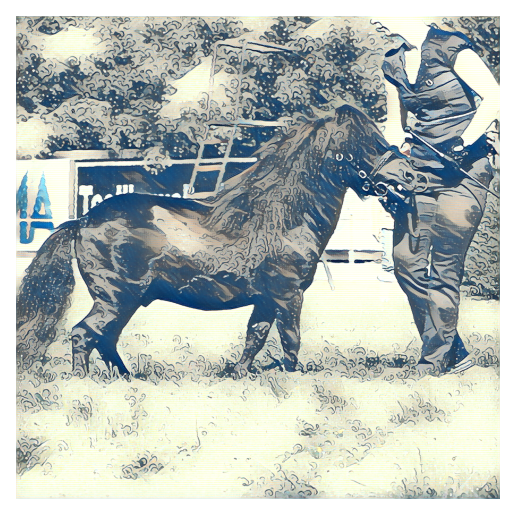

Transferring image 2/100
Time Used: 0.17183518409729004 sec


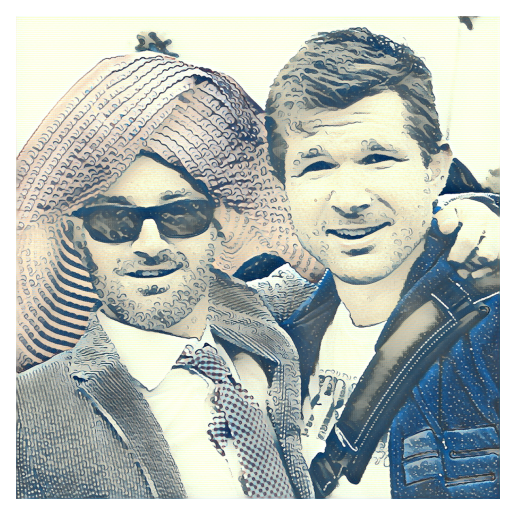

Transferring image 3/100
Time Used: 0.1495351791381836 sec


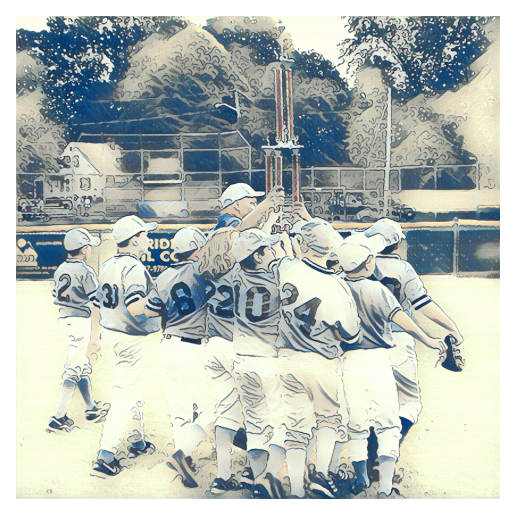

Transferring image 4/100
Time Used: 0.15047073364257812 sec


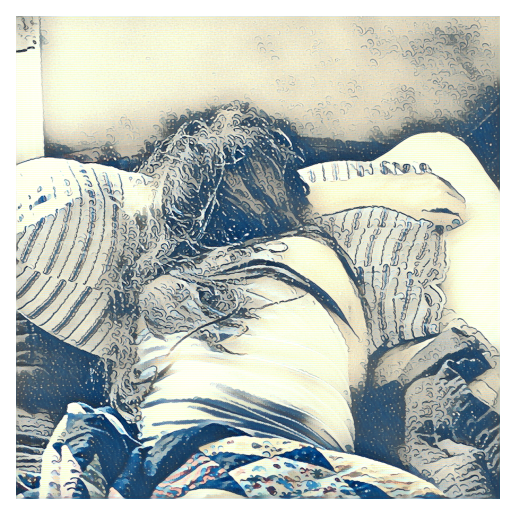

Transferring image 5/100
Time Used: 0.14989399909973145 sec


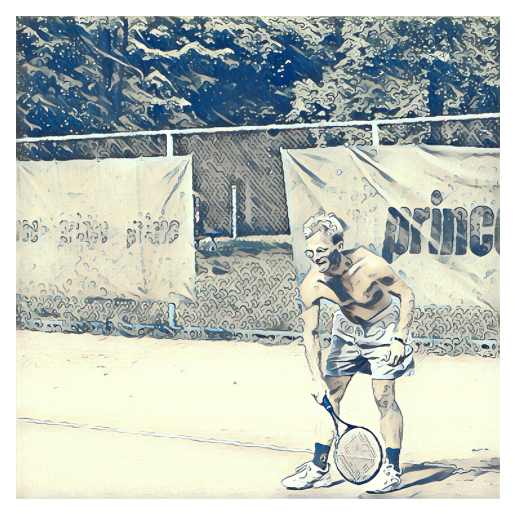

Transferring image 6/100
Time Used: 0.15072345733642578 sec


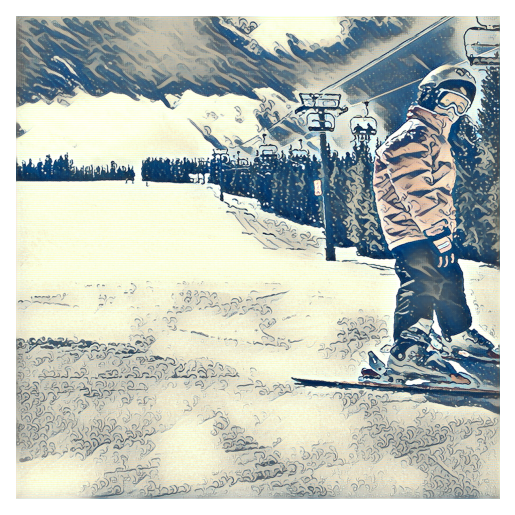

Transferring image 7/100
Time Used: 0.14958858489990234 sec


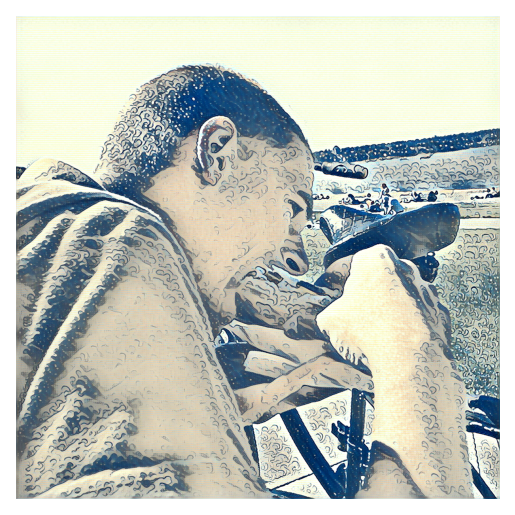

Transferring image 8/100
Time Used: 0.15057039260864258 sec


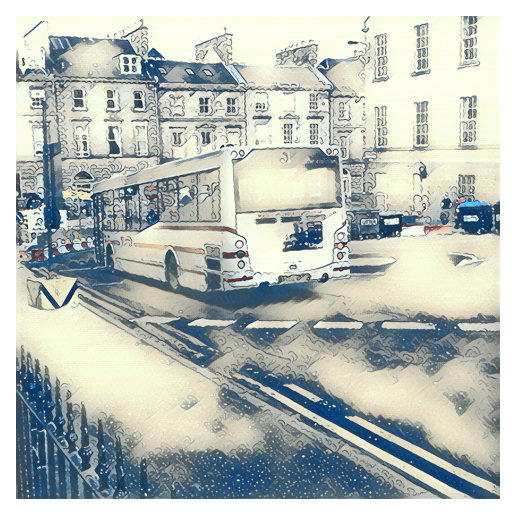

Transferring image 9/100
Time Used: 0.15088176727294922 sec


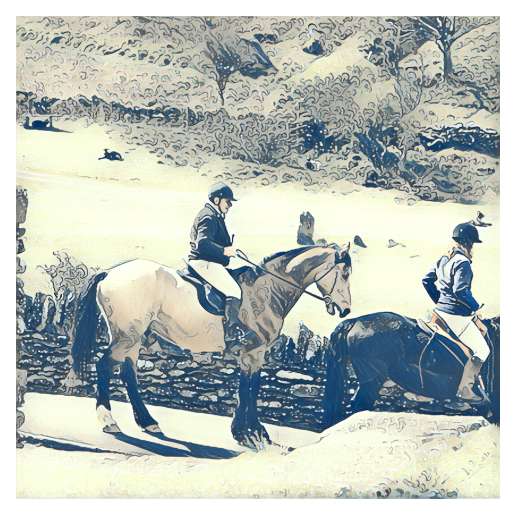

Transferring image 10/100
Time Used: 0.1519014835357666 sec


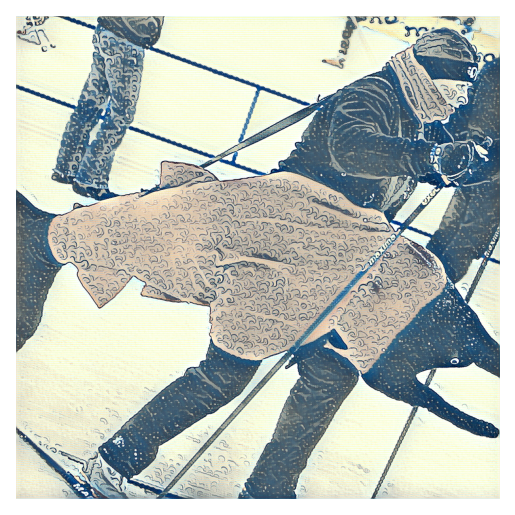

Transferring image 11/100
Time Used: 0.14966320991516113 sec


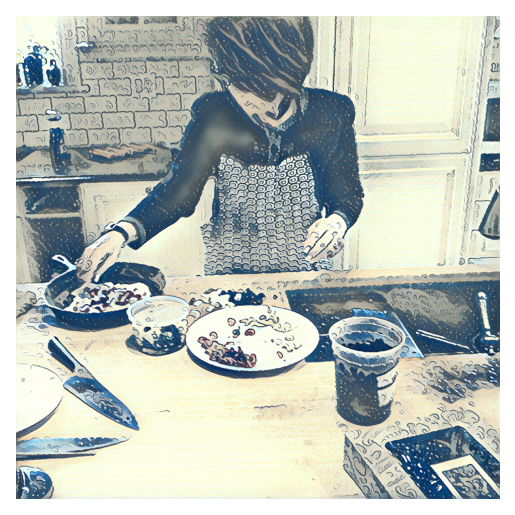

Transferring image 12/100
Time Used: 0.15233659744262695 sec


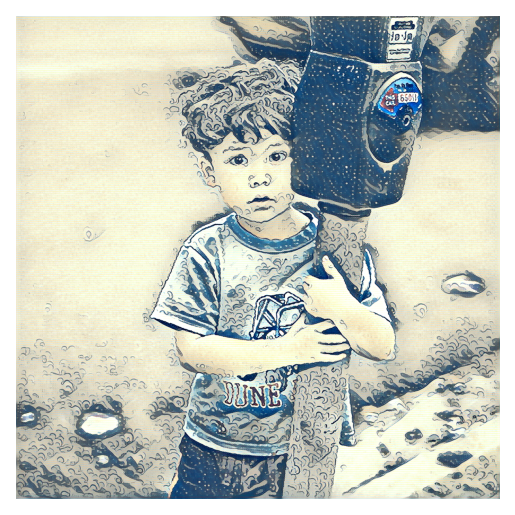

Transferring image 13/100
Time Used: 0.15015769004821777 sec


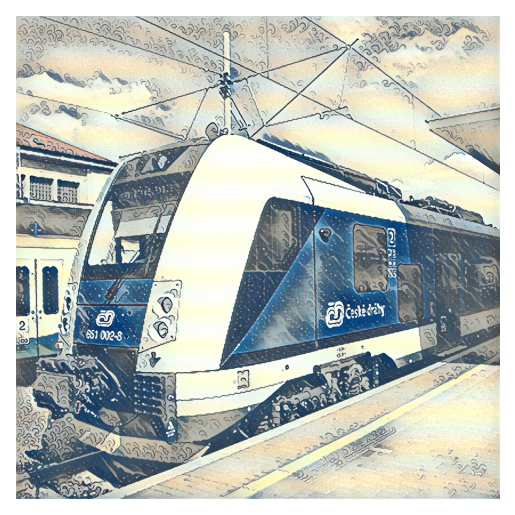

Transferring image 14/100
Time Used: 0.15085220336914062 sec


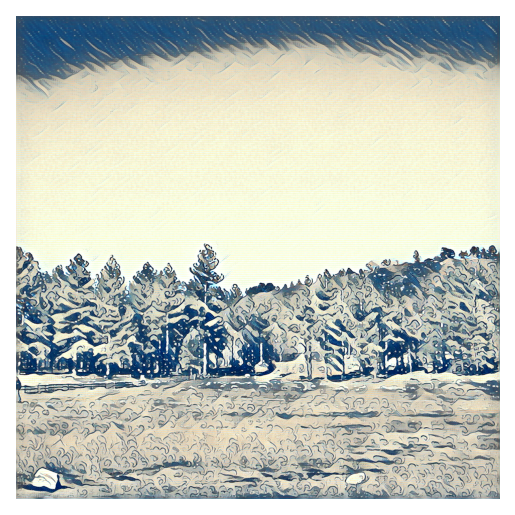

Transferring image 15/100
Time Used: 0.14942669868469238 sec


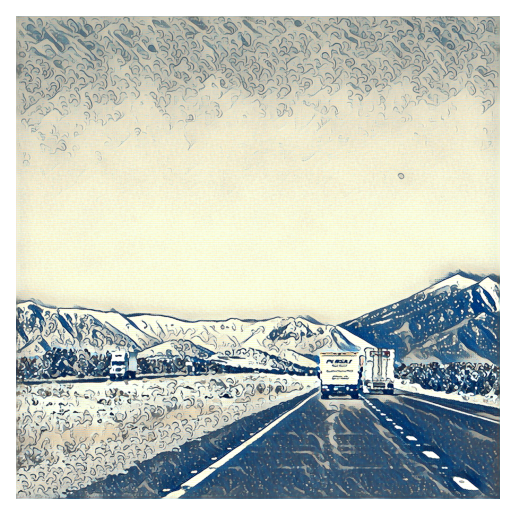

Transferring image 16/100
Time Used: 0.1499614715576172 sec


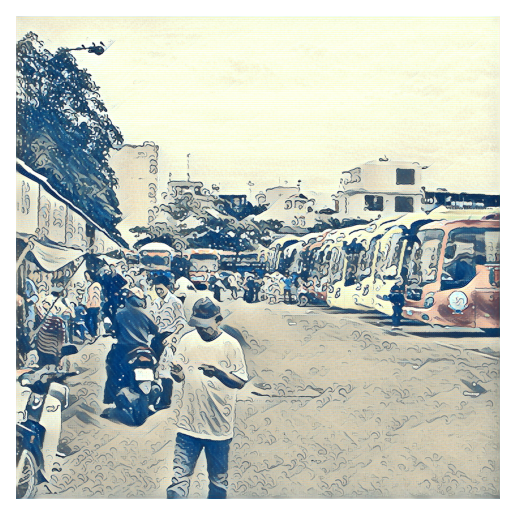

Transferring image 17/100
Time Used: 0.1534883975982666 sec


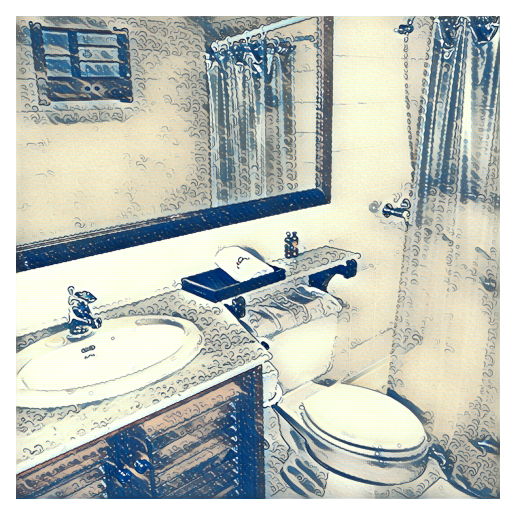

Transferring image 18/100
Time Used: 0.15468764305114746 sec


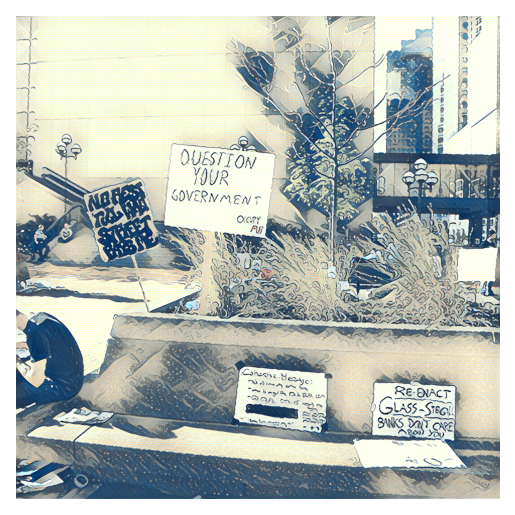

Transferring image 19/100
Time Used: 0.15070605278015137 sec


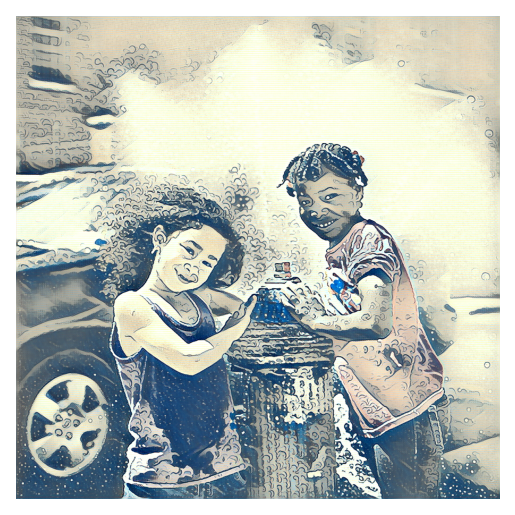

Transferring image 20/100
Time Used: 0.1517314910888672 sec


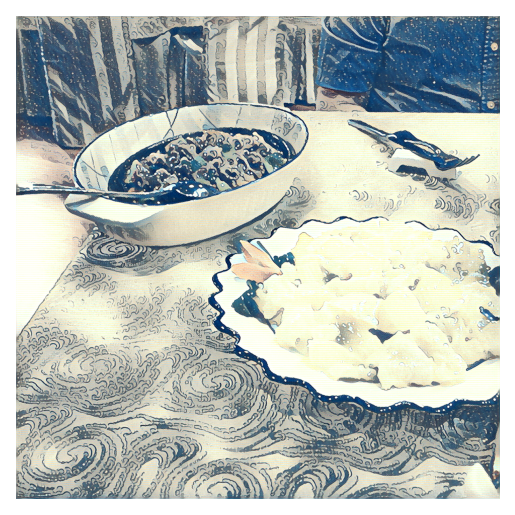

Transferring image 21/100
Time Used: 0.1507432460784912 sec


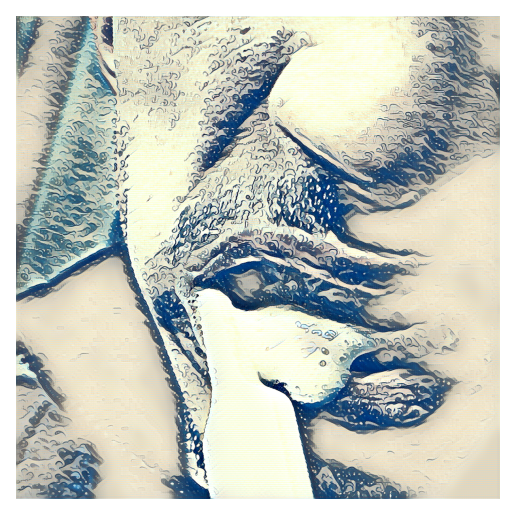

Transferring image 22/100
Time Used: 0.15330123901367188 sec


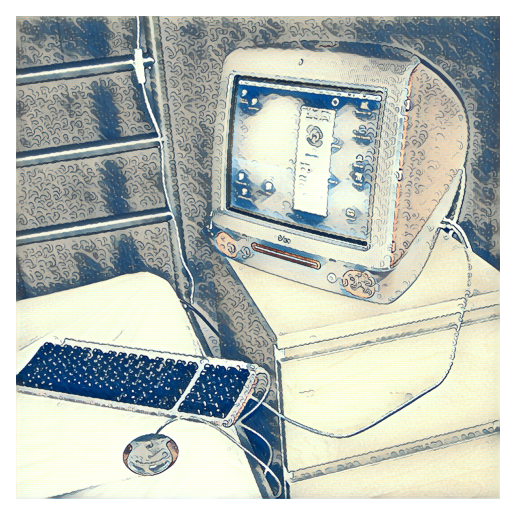

Transferring image 23/100
Time Used: 0.1577894687652588 sec


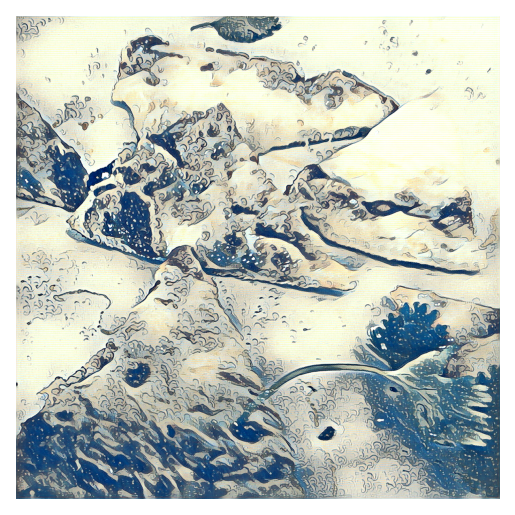

Transferring image 24/100
Time Used: 0.15181875228881836 sec


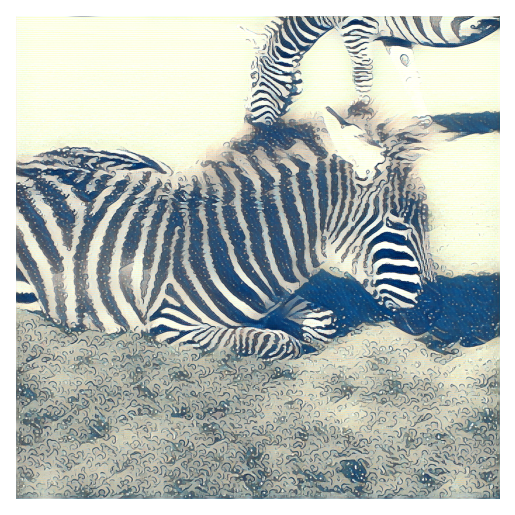

Transferring image 25/100
Time Used: 0.15381288528442383 sec


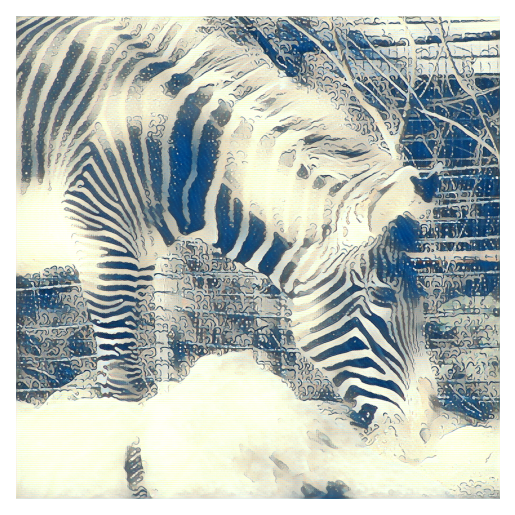

Transferring image 26/100
Time Used: 0.15231609344482422 sec


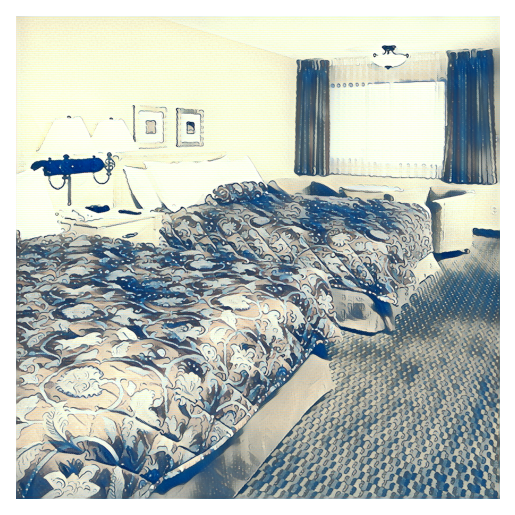

Transferring image 27/100
Time Used: 0.15886950492858887 sec


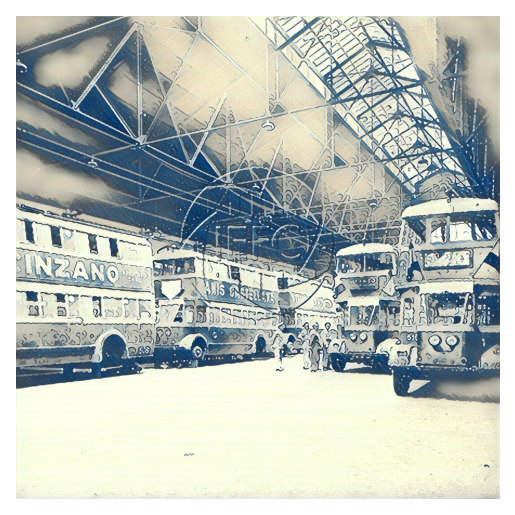

Transferring image 28/100
Time Used: 0.15120887756347656 sec


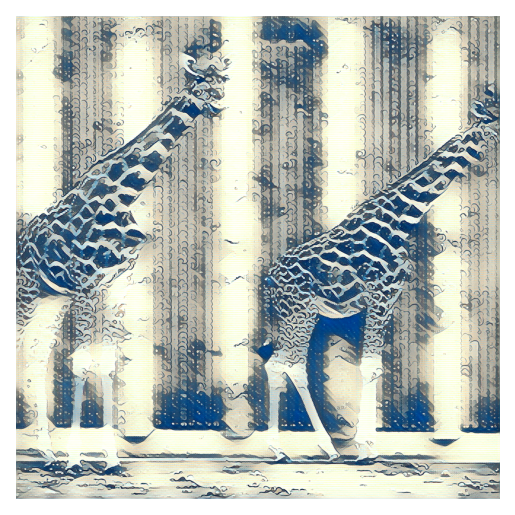

Transferring image 29/100
Time Used: 0.1519477367401123 sec


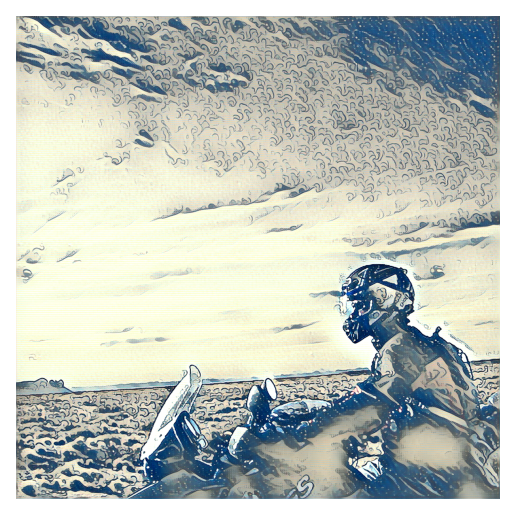

Transferring image 30/100
Time Used: 0.15184640884399414 sec


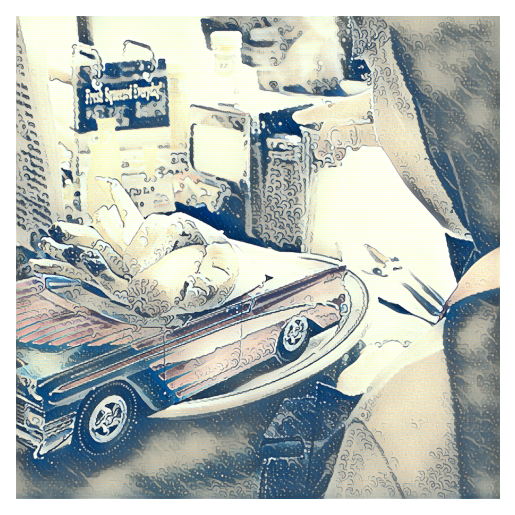

Transferring image 31/100
Time Used: 0.15134644508361816 sec


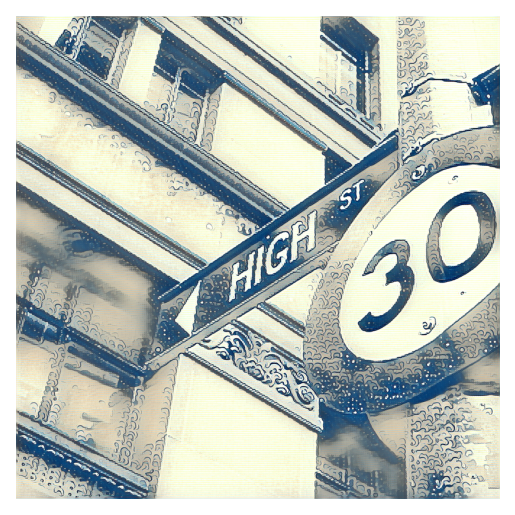

Transferring image 32/100
Time Used: 0.15220999717712402 sec


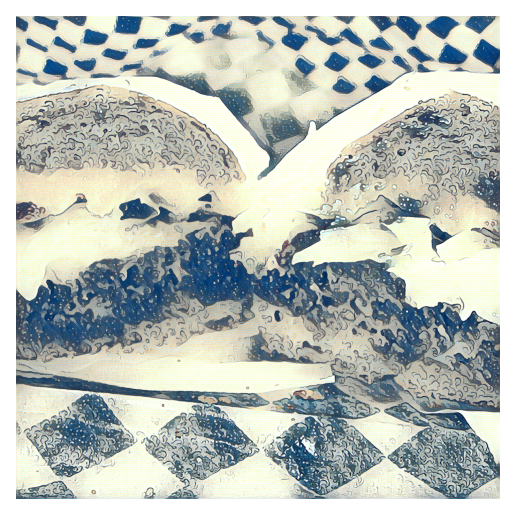

Transferring image 33/100
Time Used: 0.15509557723999023 sec


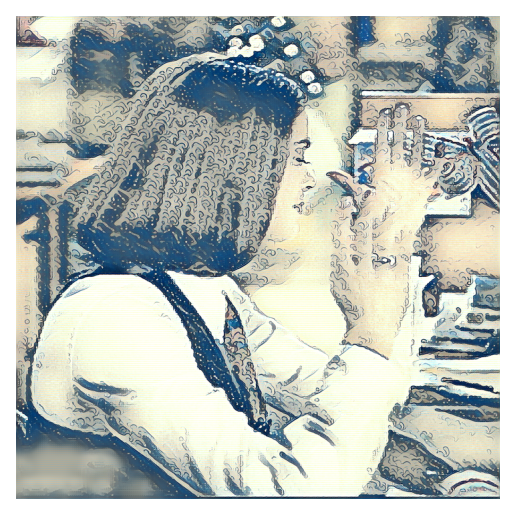

Transferring image 34/100
Time Used: 0.15305328369140625 sec


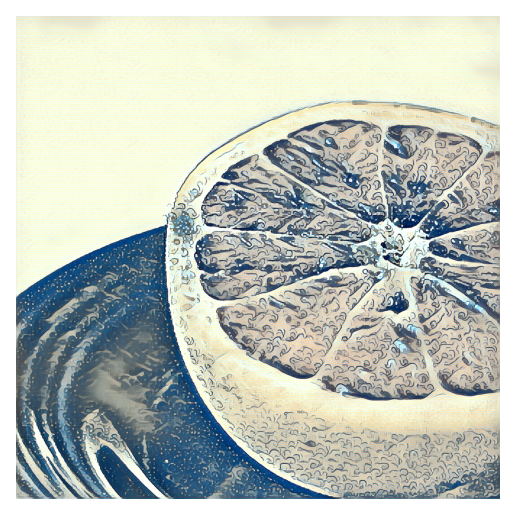

Transferring image 35/100
Time Used: 0.15087461471557617 sec


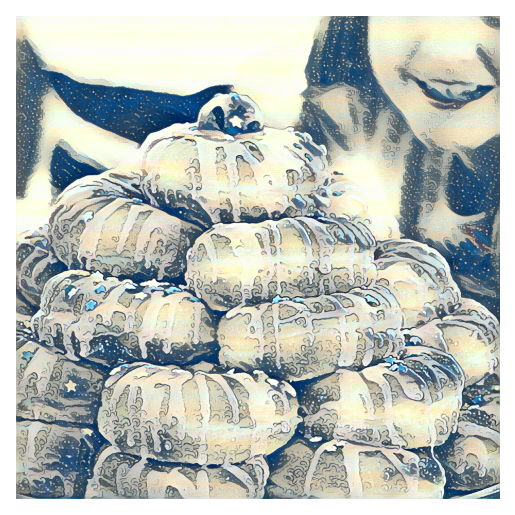

Transferring image 36/100
Time Used: 0.15344715118408203 sec


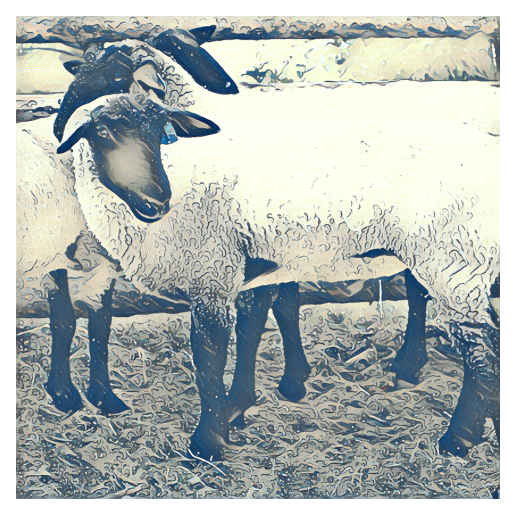

Transferring image 37/100
Time Used: 0.1525282859802246 sec


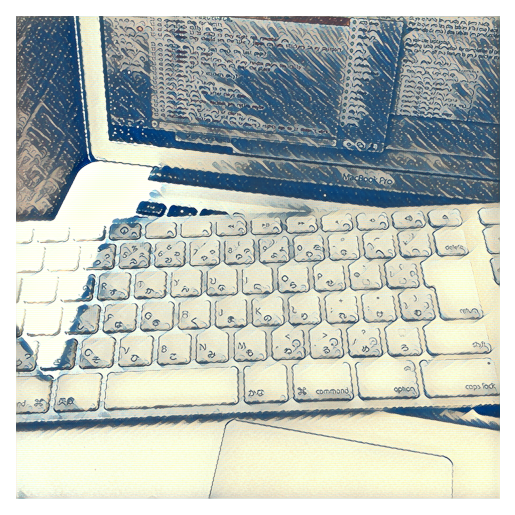

Transferring image 38/100
Time Used: 0.15046381950378418 sec


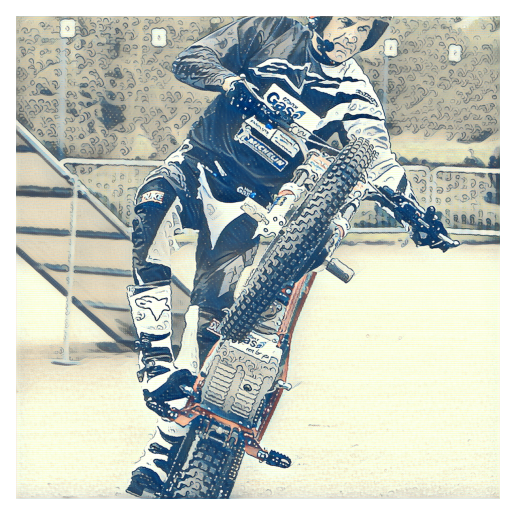

Transferring image 39/100
Time Used: 0.1523127555847168 sec


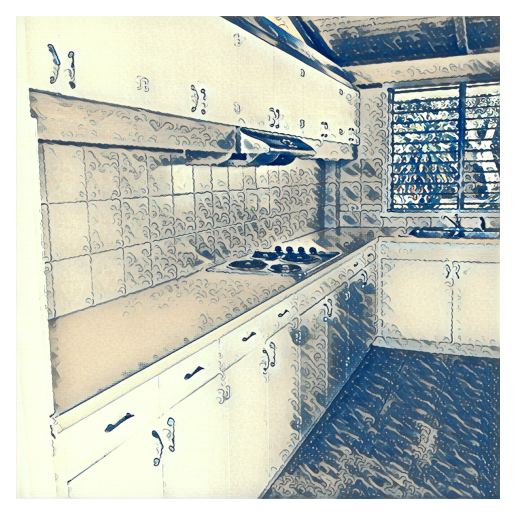

Transferring image 40/100
Time Used: 0.15204548835754395 sec


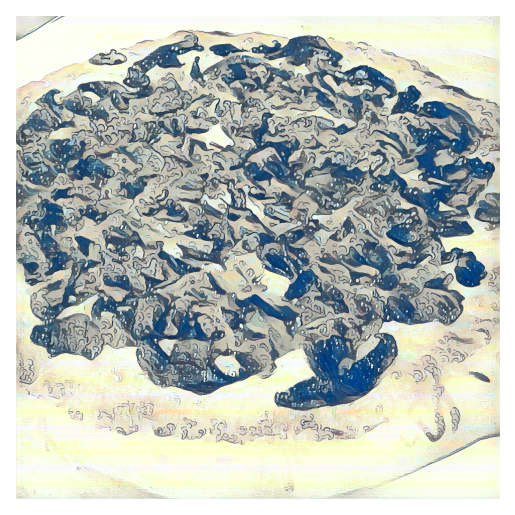

Transferring image 41/100
Time Used: 0.15940284729003906 sec


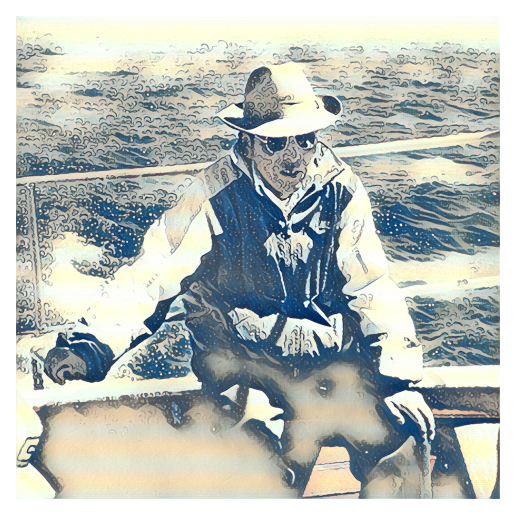

Transferring image 42/100
Time Used: 0.15520048141479492 sec


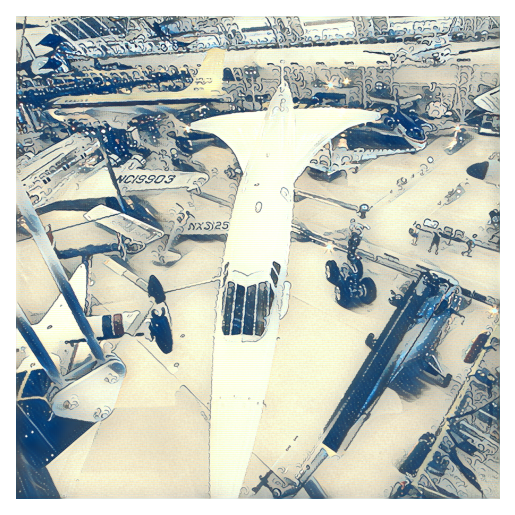

Transferring image 43/100
Time Used: 0.15195965766906738 sec


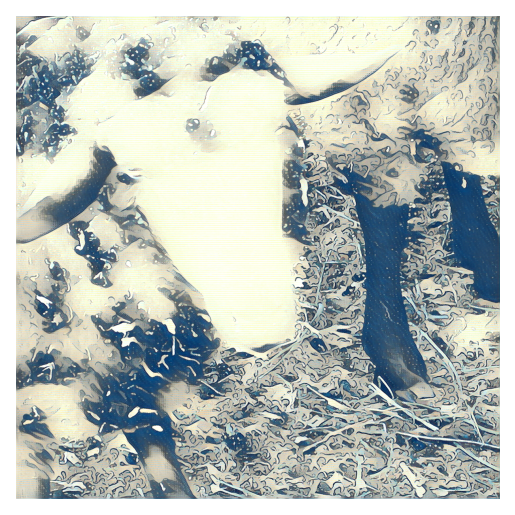

Transferring image 44/100
Time Used: 0.15329599380493164 sec


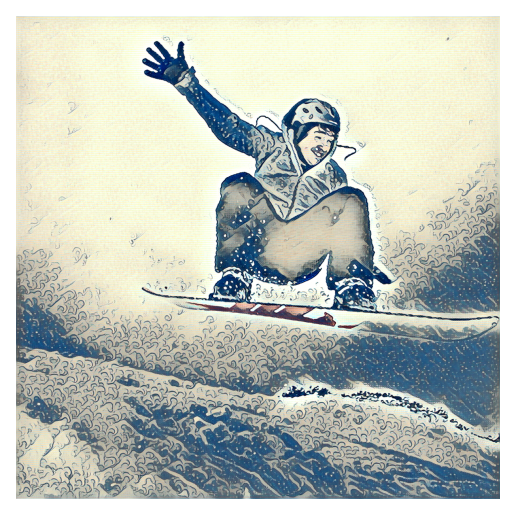

Transferring image 45/100
Time Used: 0.15255427360534668 sec


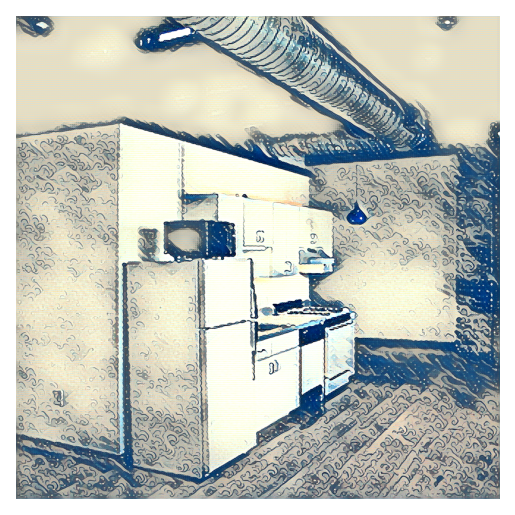

Transferring image 46/100
Time Used: 0.15078377723693848 sec


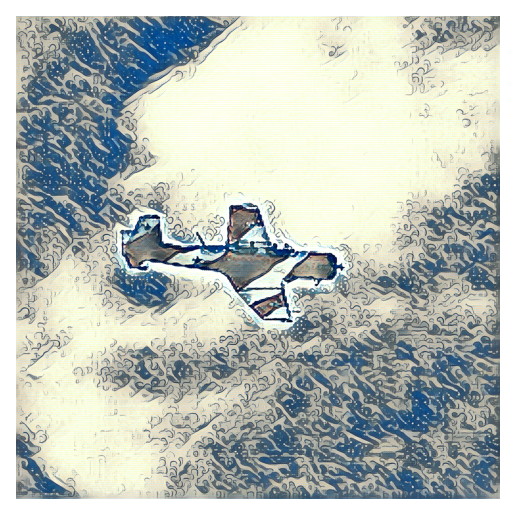

Transferring image 47/100
Time Used: 0.1541895866394043 sec


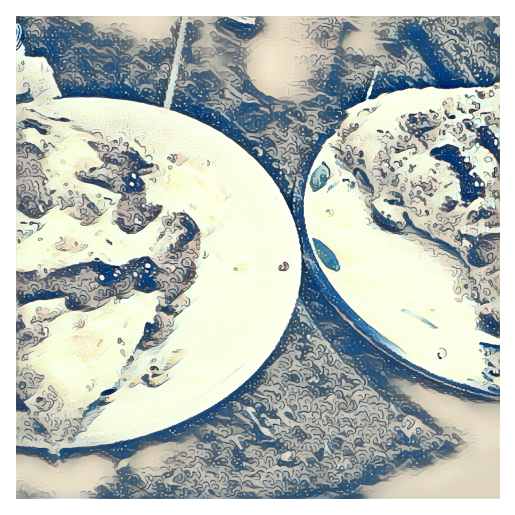

Transferring image 48/100
Time Used: 0.15699386596679688 sec


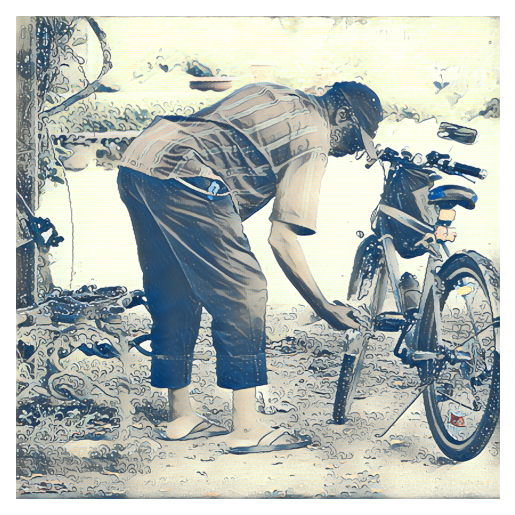

Transferring image 49/100
Time Used: 0.15328526496887207 sec


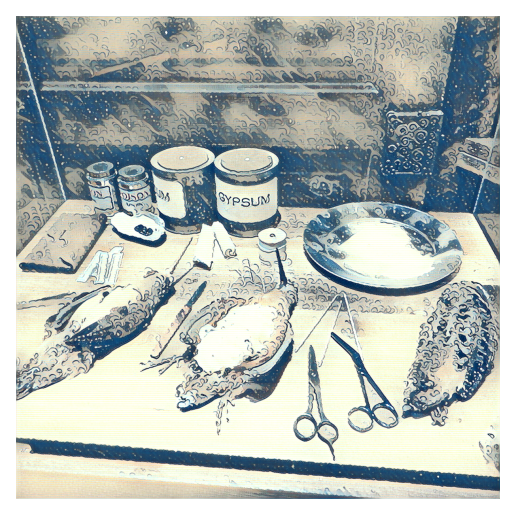

Transferring image 50/100
Time Used: 0.15562915802001953 sec


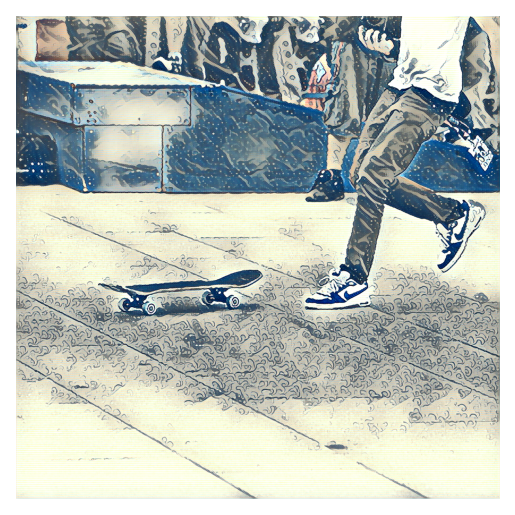

Transferring image 51/100
Time Used: 0.1568286418914795 sec


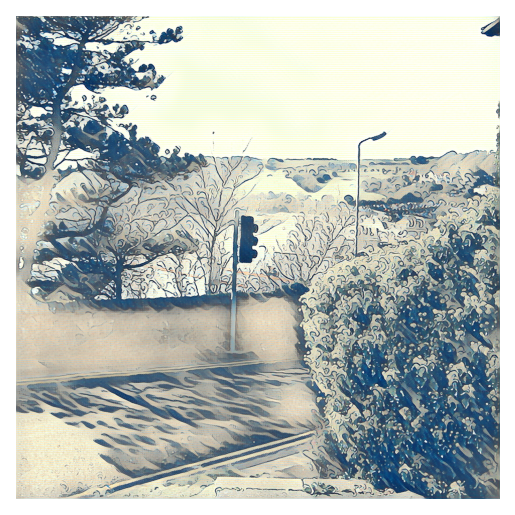

Transferring image 52/100
Time Used: 0.15268707275390625 sec


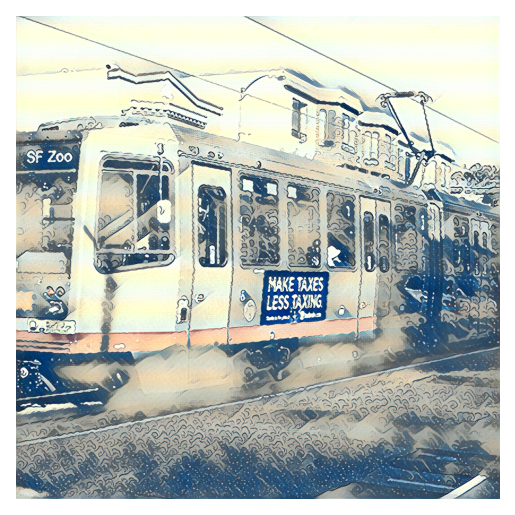

Transferring image 53/100
Time Used: 0.15275216102600098 sec


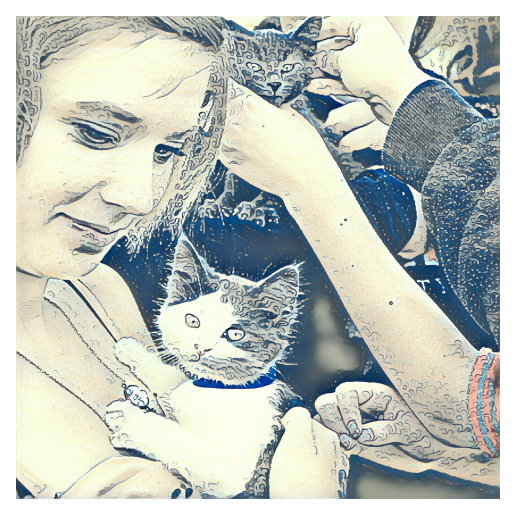

Transferring image 54/100
Time Used: 0.15219616889953613 sec


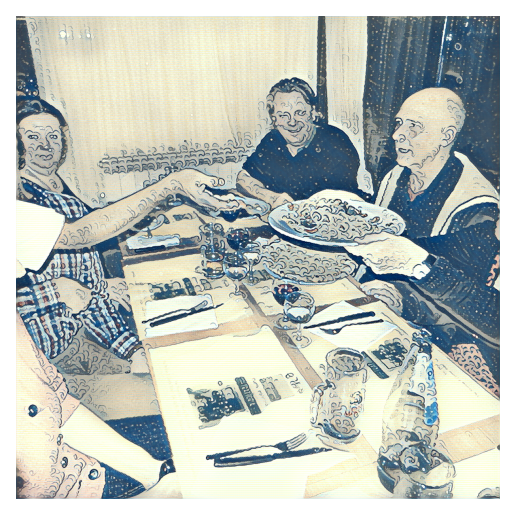

Transferring image 55/100
Time Used: 0.15329217910766602 sec


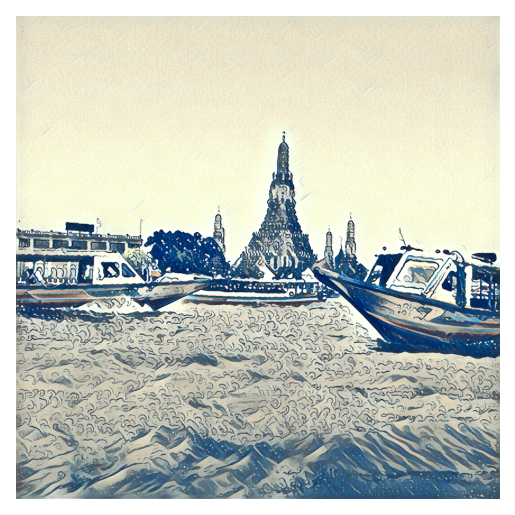

Transferring image 56/100
Time Used: 0.15371131896972656 sec


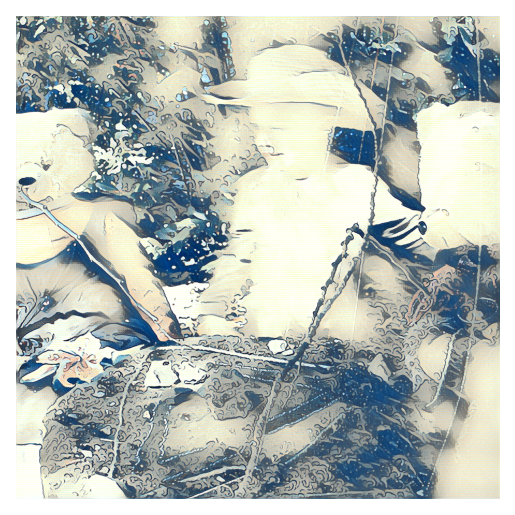

Transferring image 57/100
Time Used: 0.15404844284057617 sec


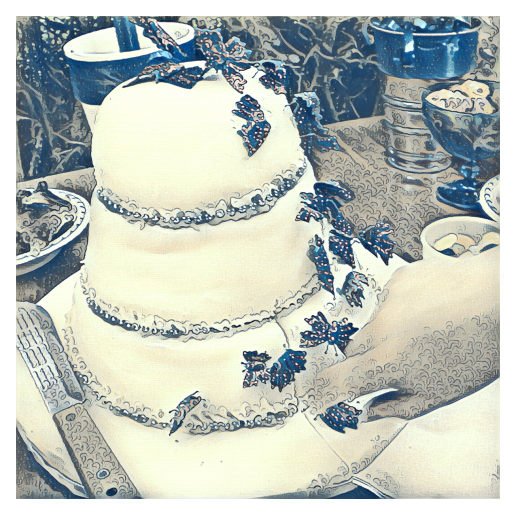

Transferring image 58/100
Time Used: 0.1540215015411377 sec


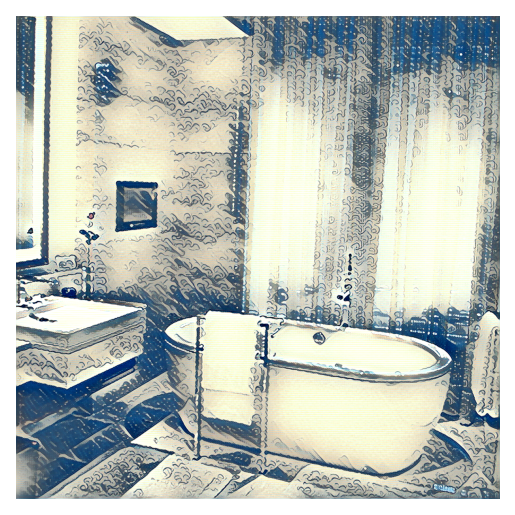

Transferring image 59/100
Time Used: 0.15239500999450684 sec


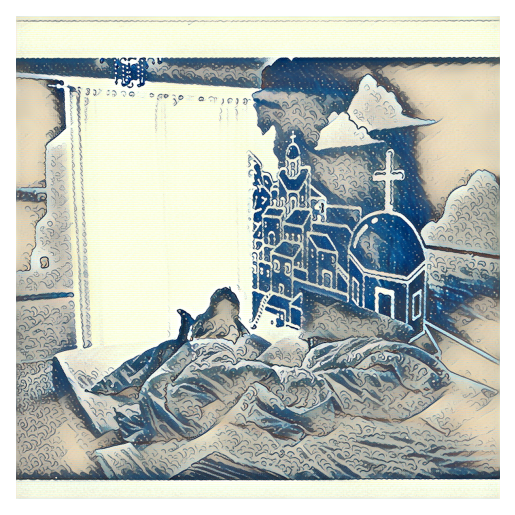

Transferring image 60/100
Time Used: 0.15223264694213867 sec


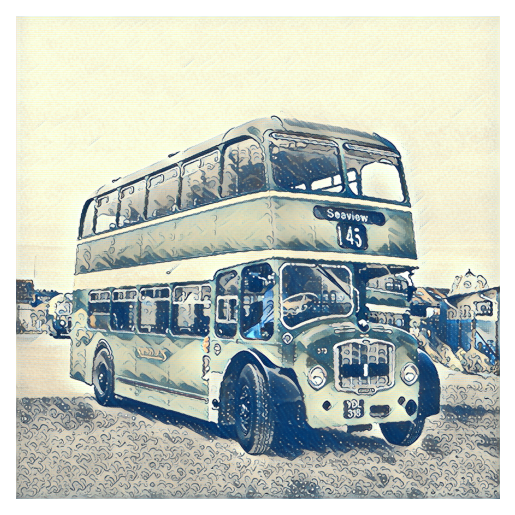

Transferring image 61/100
Time Used: 0.1528308391571045 sec


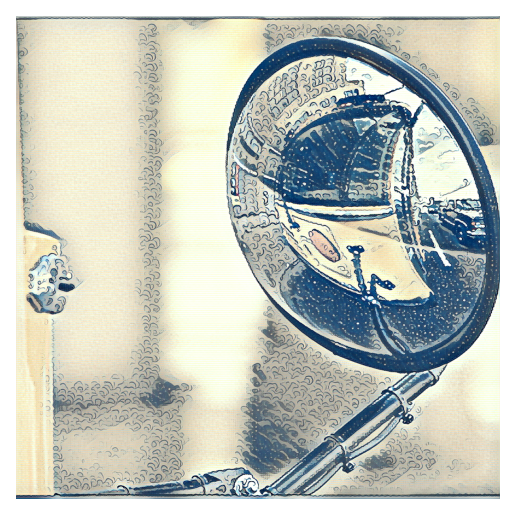

Transferring image 62/100
Time Used: 0.15332293510437012 sec


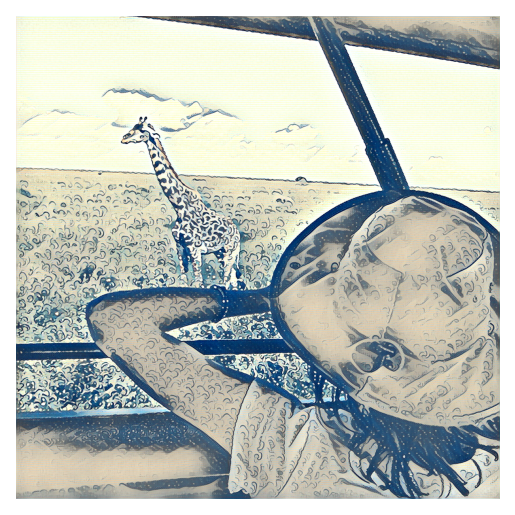

Transferring image 63/100
Time Used: 0.1540369987487793 sec


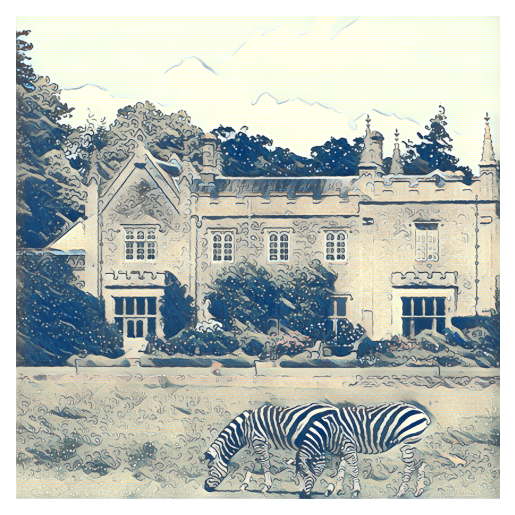

Transferring image 64/100
Time Used: 0.15309572219848633 sec


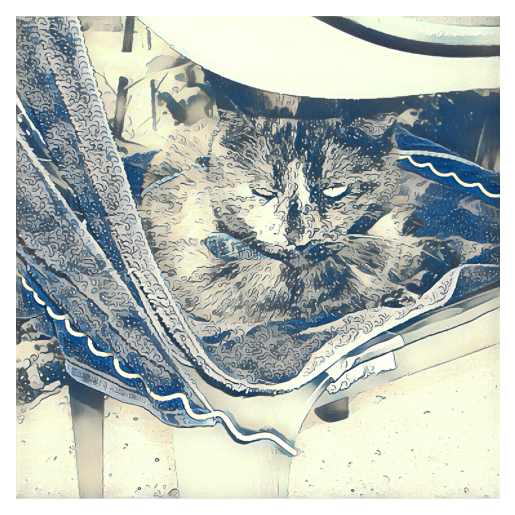

Transferring image 65/100
Time Used: 0.1557772159576416 sec


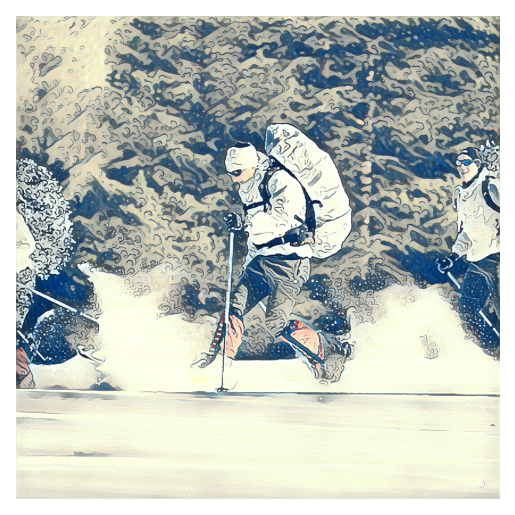

Transferring image 66/100
Time Used: 0.13083648681640625 sec


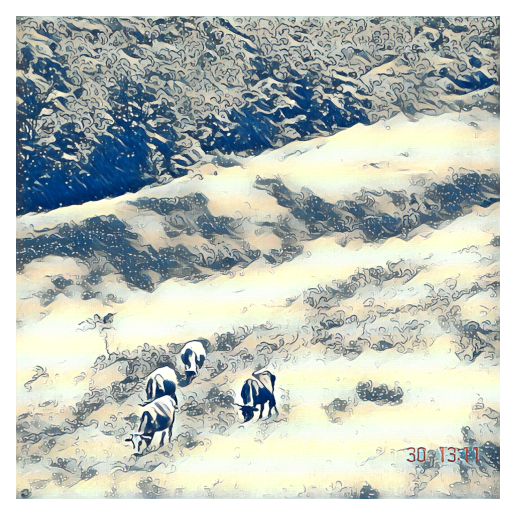

Transferring image 67/100
Time Used: 0.1521005630493164 sec
Buffered data was truncated after reaching the output size limit.

In [ ]:
@torch.no_grad()
def image_style_transfer(content_image, save_image_flag):
    # Load Transformer Network and its weights
    net = TransformerNet()
    style_weights = os.path.join(ROOT, TRANSFORMATIONS_DIR, TRANSFORMATION_IMAGE_WEIGHTS)
    net.load_state_dict(torch.load(style_weights))
    # net.load_state_dict(torch.load('/content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_29571.pth',map_location=torch.device('cpu')))
    net = net.to(device)

    garbage_collect()

    # Style transfer
    start = time.time()
    content_tensor = itot(content_image).to(device)
    stylized_tensor = net(content_tensor)
    stylized_image = ttoi(stylized_tensor.detach())
    end = time.time()
    time_used = end - start
    print(f"Time Used: {end - start} sec")
    
    show_image(stylized_image)

    time_id = f"{datetime.now().strftime('%Y%m%d')}_{int(time.time())}"
    if save_image_flag:  
      result_saving_path = os.path.join(ROOT, RESULT_IMAGE_DIR, f"{RESULT_IMAGE_NAME}_{time_id}.jpg")
      save_image(stylized_image, result_saving_path)
    return time_used


if MODE == 'IMAGE':
    content_image_path = os.path.join(ROOT, CONTENT_IMAGE_DIR, CONTENT_IMAGE_NAME)
    # Load content image
    content_image = load_image(content_image_path)
    image_style_transfer(content_image, True)
elif MODE == 'VALIDATION':
    VAL_IMAGE_SIZE = 1024
    # Dataset and Dataloader
    transform = transforms.Compose([
        transforms.Resize(VAL_IMAGE_SIZE),
        transforms.CenterCrop(VAL_IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x.mul(255))
    ])
    val_dataset = datasets.ImageFolder(DATASET_PATH, transform=transform)
    val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=1, shuffle=True)
    count = 0
    training_durations = np.zeros(100)
    for content_batch, _ in val_loader:
      print(f'Transferring image {count+1}/100')
      content = content_batch[:,[2,1,0]].to(device)
      content_sample_tensor = content[0].clone().detach().unsqueeze(dim=0)
      content_sample_image = ttoi(content_sample_tensor.clone().detach())
      # Start transferring
      time_used = image_style_transfer(content_sample_image, False)
      # End
      training_durations[count] = time_used
      count += 1
      if count == 100:
        break
    avg_duration = np.mean(training_durations)
    print(f'The average time for transferring images in the size of {VAL_IMAGE_SIZE} is {avg_duration} sec')

## **Section 8: Batch Image Style Transfer**

This is a helper function called in video style transfer.

In [ ]:
def batch_image_style_transfer(extracted_frames_dataset_dir, transformed_frames_saving_dir, batch_size=1):
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x.mul(255))
    ])
    frame_dataset = ImageFolderWithPaths(extracted_frames_dataset_dir, transform=transform)
    image_loader = torch.utils.data.DataLoader(frame_dataset, batch_size=batch_size)

    net = TransformerNet()
    style_weights = os.path.join(ROOT, TRANSFORMATIONS_DIR, TRANSFORMATION_VIDEO_WEIGHTS)
    net.load_state_dict(torch.load(style_weights))
    net = net.to(device)

    # Batch transform
    with torch.no_grad():
        for content_batch, _, path in image_loader:
            torch.cuda.empty_cache()

            # Transform frame
            transformed_tensor = net(content_batch.to(device)).detach()

            # Save transformed frames
            for i in range(len(path)):
                transformed_frame = ttoi(transformed_tensor[i])
                frame_name = os.path.basename(path[i])
                frame_saving_path = os.path.join(transformed_frames_saving_dir, frame_name)
                save_image(transformed_frame, frame_saving_path)

## **Section 9: Video Style Transfer Pipeline**

Steps to run *video style transfer*:
1. Properly modify configs (Section 1) and run it
    - Remember to set `MODE = 'VIDEO'`
2. Run everything Section 2, 3, and 4
3. Run Section 8
4. Run `video_style_transfer` (the cell below)

In [ ]:
def video_style_transfer(video_path):
    start_time = time.time()

    # Save frames in video in a directory
    extract_video_frames(video_path)
    
    # Batch transform frames
    batch_image_style_transfer(CONTENT_FRAMES_DATASET_DIR, STYLE_FRAMES_SAVING_PATH, batch_size=BATCH_SIZE)

    # Get specs of the video
    height, width, fps = extract_video_specs(video_path)

    # Combine all the transfromed frames into a video
    time_id = f"{datetime.now().strftime('%Y%m%d')}_{int(time.time())}"
    result_saving_path = os.path.join(ROOT, RESULT_VIDEO_DIR, f"{RESULT_VIDEO_NAME}_{time_id}.mp4")
    create_video(STYLE_FRAMES_SAVING_PATH, result_saving_path, fps, int(height), int(width))

    end_time = time.time()
    print(f"Time used: {end_time-start_time}")


if MODE == 'VIDEO':
    content_video_path = os.path.join(ROOT, CONTENT_VIDEO_DIR, CONTENT_VIDEO_NAME)
    video_style_transfer(content_video_path)

Content video frames extracted => Number of frames: 42
Video specs extracted => width: 1024.0 height: 576.0 fps: 24.499323094159937
Video saved at /content/drive/MyDrive/Colab_Notebooks/CIS5810/style_transfer/videos/result_videos/car_shanghai/walkway_mosaic_transformed_20221208_1670459154.mp4
Time used: 20.306204557418823
